# Agrupamento de Clientes com Machine Learning


Conjunto de dados extraido da plataforma Kanggle

Link: https://www.kaggle.com/datasets/muhammadshahidazeem/customer-churn-dataset

# 1. Introdução

O agrupamento de clientes consiste é uma técnica que visa dividir o consumidores de determinada empresa em grupos específicos, os quais compartilham características em comuns, tais como desejos, hábitos, renda, gostos, dentre outros. Assim, é possível entender o perfil de consumo dos clientes e direcionar melhor as vendas.

# 2. Objetivo

O objetivo desse projeto é a aplicação de algoritmos de agrupamento com a finalidade de agrupar os clientes com base nos atributos/características fornecidas pela base de dados.

# 3. Justificativa

O agrupamento de clientes permite entender o perfil de cada um deles e, com isso, direcionar melhor as vendas, constribuido para o aumento de receitas.

# 4. Metodologia

# 5. Importação das bibliotecas utilizadas ao longo de todo o projeto

In [1]:
!pip -q install inflection

In [3]:
!pip -q install pyod

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 153.4/153.4 kB 2.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done


In [2]:
import pandas as pd                                   # (Biblioteca que contém os comandos para ler as planilhas)
import numpy as np                                    # (Biblioteca que contém os comandos para realização de cálculos)
import matplotlib.pyplot as plt                       # (Para geração de gráficos)
import statsmodels.formula.api as sm                  # (Para criar o modelo de regressão linear múltipla)
import seaborn as sns
import matplotlib.pyplot as plt
import statistics as sts
import inflection                                                     # usado ao renomear colunas na subseção
import plotly.express as px
from pyod.models.knn import KNN                                   # Para gerar detecção de outliers com o algoritmo KNN
import sklearn
from IPython.display       import Image                                      # Para importar imagens
from scipy                 import stats as ss                                # Para executar o teste de shapiro
import pylab
from scipy.stats import norm                                                  # Para gerar a distribuição normal
from sklearn.preprocessing import LabelEncoder                                # Transforma os dados categóricos em dados númericos.
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.preprocessing import StandardScaler                               # escalonamento
from sklearn.cluster import KMeans                                             # Para aplicação do algoritmo K-means
from sklearn.decomposition import PCA                                     # Para aplicação do PCA
from scipy.cluster.hierarchy import dendrogram, linkage                   # Para o dendograma
from sklearn.cluster import DBSCAN                                        # Para o DBSCAN


# 6. ETAPA I: Coleta de dados

## 6.1 Carregando e Visualizando a base de dados

In [3]:
# Carregando e Visualizando a base de dados

base_dados_clientes= pd.read_csv('customer_churn_dataset-training-master.csv')
base_dados_clientes

,CustomerID,Age,Gender,Tenure,Usage Frequency,Support Calls,Payment Delay,Subscription Type,Contract Length,Total Spend,Last Interaction,Churn
0,2.0,30.0,Female,39.0,14.0,5.0,18.0,Standard,Annual,932.00,17.0,1.0
1,3.0,65.0,Female,49.0,1.0,10.0,8.0,Basic,Monthly,557.00,6.0,1.0
2,4.0,55.0,Female,14.0,4.0,6.0,18.0,Basic,Quarterly,185.00,3.0,1.0
3,5.0,58.0,Male,38.0,21.0,7.0,7.0,Standard,Monthly,396.00,29.0,1.0
4,6.0,23.0,Male,32.0,20.0,5.0,8.0,Basic,Monthly,617.00,20.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...
440828,449995.0,42.0,Male,54.0,15.0,1.0,3.0,Premium,Annual,716.38,8.0,0.0
440829,449996.0,25.0,Female,8.0,13.0,1.0,20.0,Premium,Annual,745.38,2.0,0.0
440830,449997.0,26.0,Male,35.0,27.0,1.0,5.0,Standard,Quarterly,977.31,9.0,0.0
440831,449998.0,28.0,Male,55.0,14.0,2.0,0.0,Standard,Quarterly,602.55,2.0,0.0


## 6.2 Fazendo uma cópia da base de dados

In [4]:
base_dados_clientes1 = base_dados_clientes.copy()
base_dados_clientes1

,CustomerID,Age,Gender,Tenure,Usage Frequency,Support Calls,Payment Delay,Subscription Type,Contract Length,Total Spend,Last Interaction,Churn
0,2.0,30.0,Female,39.0,14.0,5.0,18.0,Standard,Annual,932.00,17.0,1.0
1,3.0,65.0,Female,49.0,1.0,10.0,8.0,Basic,Monthly,557.00,6.0,1.0
2,4.0,55.0,Female,14.0,4.0,6.0,18.0,Basic,Quarterly,185.00,3.0,1.0
3,5.0,58.0,Male,38.0,21.0,7.0,7.0,Standard,Monthly,396.00,29.0,1.0
4,6.0,23.0,Male,32.0,20.0,5.0,8.0,Basic,Monthly,617.00,20.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...
440828,449995.0,42.0,Male,54.0,15.0,1.0,3.0,Premium,Annual,716.38,8.0,0.0
440829,449996.0,25.0,Female,8.0,13.0,1.0,20.0,Premium,Annual,745.38,2.0,0.0
440830,449997.0,26.0,Male,35.0,27.0,1.0,5.0,Standard,Quarterly,977.31,9.0,0.0
440831,449998.0,28.0,Male,55.0,14.0,2.0,0.0,Standard,Quarterly,602.55,2.0,0.0


## 6.3 Renomeando colunas

In [5]:
# Renomeando as colunas

lista_original = ['CustomerID', 'Age','Gender','Tenure','Usage Frequency', 'Support Calls', 'Payment Delay', 'Subscription Type', 'Contract Length', 'Total Spend', 'Last Interaction','Churn']
lista_renomeada = ["ID_cliente", "Idade", "Gênero", "Posse", "Frequência_de_uso", "Chamadas_de_suporte", "Atraso_de_pagamento", "Tipo_de_assinatura", "Duração_do_contrato", "Gasto_Total","Última_interação","Churn"]
base_dados_clientes1 = pd.read_csv('customer_churn_dataset-training-master.csv', sep =",", usecols=lista_original)
base_dados_clientes1.columns = lista_renomeada
base_dados_clientes1

,ID_cliente,Idade,Gênero,Posse,Frequência_de_uso,Chamadas_de_suporte,Atraso_de_pagamento,Tipo_de_assinatura,Duração_do_contrato,Gasto_Total,Última_interação,Churn
0,2.0,30.0,Female,39.0,14.0,5.0,18.0,Standard,Annual,932.00,17.0,1.0
1,3.0,65.0,Female,49.0,1.0,10.0,8.0,Basic,Monthly,557.00,6.0,1.0
2,4.0,55.0,Female,14.0,4.0,6.0,18.0,Basic,Quarterly,185.00,3.0,1.0
3,5.0,58.0,Male,38.0,21.0,7.0,7.0,Standard,Monthly,396.00,29.0,1.0
4,6.0,23.0,Male,32.0,20.0,5.0,8.0,Basic,Monthly,617.00,20.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...
440828,449995.0,42.0,Male,54.0,15.0,1.0,3.0,Premium,Annual,716.38,8.0,0.0
440829,449996.0,25.0,Female,8.0,13.0,1.0,20.0,Premium,Annual,745.38,2.0,0.0
440830,449997.0,26.0,Male,35.0,27.0,1.0,5.0,Standard,Quarterly,977.31,9.0,0.0
440831,449998.0,28.0,Male,55.0,14.0,2.0,0.0,Standard,Quarterly,602.55,2.0,0.0


# 7. ETAPA II: Verificando inconsistências nos dados

## 7.1 Dimensão/Tamanho dos dados

In [ ]:
# Verificando quantidade de linhas e colunas

base_dados_clientes1.shape

(440833, 12)

* O conjunto de dados possui 440833 linhas e 12 colunas.

## 7.2 Tipo dos dados

In [ ]:
# Verificando o tipo dos dados

Tipo_de_dados = pd.DataFrame(base_dados_clientes1.dtypes)
Tipo_de_dados

,0
ID_cliente,float64
Idade,float64
Gênero,object
Posse,float64
Frequência_de_uso,float64
Chamadas_de_suporte,float64
Atraso_de_pagamento,float64
Tipo_de_assinatura,object
Duração_do_contrato,object
Gasto_Total,float64


In [ ]:
# Informações gerais sobre os dados

informacoes_gerais_dos_dados = base_dados_clientes1.info()
informacoes_gerais_dos_dados

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 440833 entries, 0 to 440832
Data columns (total 12 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   ID_cliente           440832 non-null  float64
 1   Idade                440832 non-null  float64
 2   Gênero               440832 non-null  object 
 3   Posse                440832 non-null  float64
 4   Frequência_de_uso    440832 non-null  float64
 5   Chamadas_de_suporte  440832 non-null  float64
 6   Atraso_de_pagamento  440832 non-null  float64
 7   Tipo_de_assinatura   440832 non-null  object 
 8   Duração_do_contrato  440832 non-null  object 
 9   Gasto_Total          440832 non-null  float64
 10  Última_interação     440832 non-null  float64
 11  Churn                440832 non-null  float64
dtypes: float64(9), object(3)
memory usage: 40.4+ MB


## 7.3 Verificando existência de valores nulos

In [ ]:
# Verificiando a existência de valores nulos

valores_nulos=pd.DataFrame(base_dados_clientes1.isnull().sum(),columns=['Números De Nulos'])
valores_nulos['Porcentagem (%)']=valores_nulos['Números De Nulos']/len(base_dados_clientes1)*100
valores_nulos

,Números De Nulos,Porcentagem (%)
ID_cliente,1,0.000227
Idade,1,0.000227
Gênero,1,0.000227
Posse,1,0.000227
Frequência_de_uso,1,0.000227
Chamadas_de_suporte,1,0.000227
Atraso_de_pagamento,1,0.000227
Tipo_de_assinatura,1,0.000227
Duração_do_contrato,1,0.000227
Gasto_Total,1,0.000227


* Todas as colunas possui 1 valor nulo. Cada valor nulo de cada coluna representa 0.000227% da mesma.

## 7.4 Verificando existência de valores inconsistentes

* Aparentemente não há valores inconsistentes na base de dados.

## 7.5 Verificando a existência de dados duplicados

In [ ]:
# Verificando a existência de dados duplicados

base_dados_clientes1[base_dados_clientes1.duplicated()]

,ID_cliente,Idade,Gênero,Posse,Frequência_de_uso,Chamadas_de_suporte,Atraso_de_pagamento,Tipo_de_assinatura,Duração_do_contrato,Gasto_Total,Última_interação,Churn


In [ ]:
base_dados_clientes1.duplicated().any()

False

* Não há valores duplicados.

## 7.6 Conclusões

Foi dentificado os seguintes problemas:
    
* Em todas as colunas há um valor nulo.

# 8. ETAPA III: Limpeza e Tratamento dos Dados

## 8.1 Tratando NANs (Excluindo NANs)

### 8.1.1 Filtrando NANs

In [6]:
# Filtrando os valores faltantes

base_dados_clientes1.loc[pd.isnull(base_dados_clientes1['ID_cliente'])]


,ID_cliente,Idade,Gênero,Posse,Frequência_de_uso,Chamadas_de_suporte,Atraso_de_pagamento,Tipo_de_assinatura,Duração_do_contrato,Gasto_Total,Última_interação,Churn
199295,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### 8.1.2 Excluindo as linhas com os valores faltantes

In [7]:
# Excluindo as linhas com os valores faltantes

base_dados_clientes2 = base_dados_clientes1.dropna() # Utilizamos o comando dropna com a variável dataframe atribuindo isso a uma nova variável.
base_dados_clientes2                           # Chamamos essa nova variável de dataframe1. Ela agora será a nossa nova base de dados.
                                         # Só que agora sem os valores faltantes.

,ID_cliente,Idade,Gênero,Posse,Frequência_de_uso,Chamadas_de_suporte,Atraso_de_pagamento,Tipo_de_assinatura,Duração_do_contrato,Gasto_Total,Última_interação,Churn
0,2.0,30.0,Female,39.0,14.0,5.0,18.0,Standard,Annual,932.00,17.0,1.0
1,3.0,65.0,Female,49.0,1.0,10.0,8.0,Basic,Monthly,557.00,6.0,1.0
2,4.0,55.0,Female,14.0,4.0,6.0,18.0,Basic,Quarterly,185.00,3.0,1.0
3,5.0,58.0,Male,38.0,21.0,7.0,7.0,Standard,Monthly,396.00,29.0,1.0
4,6.0,23.0,Male,32.0,20.0,5.0,8.0,Basic,Monthly,617.00,20.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...
440828,449995.0,42.0,Male,54.0,15.0,1.0,3.0,Premium,Annual,716.38,8.0,0.0
440829,449996.0,25.0,Female,8.0,13.0,1.0,20.0,Premium,Annual,745.38,2.0,0.0
440830,449997.0,26.0,Male,35.0,27.0,1.0,5.0,Standard,Quarterly,977.31,9.0,0.0
440831,449998.0,28.0,Male,55.0,14.0,2.0,0.0,Standard,Quarterly,602.55,2.0,0.0


## 8.2 Detecção e Tratamento de Outliers

### 8.2.1 Detecção de Outliers

###### 8.2.1.1 Detectando outiliers com o Boxplot

Text(0.5, 1.0, 'Última_interação')

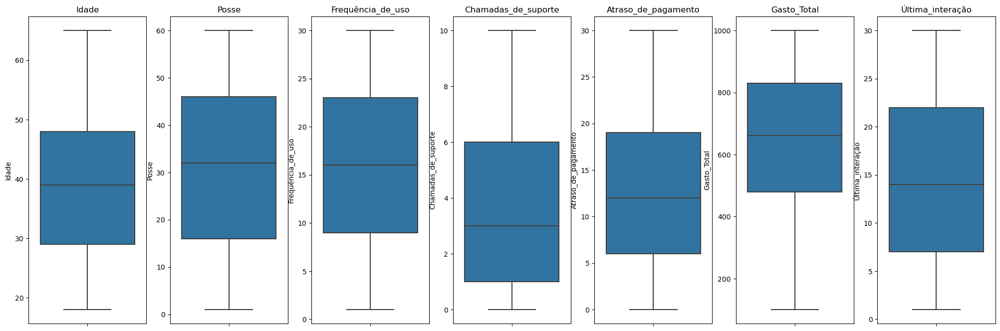

In [ ]:
# Detectando outliers com o boxplot

plt.figure(figsize=(25, 8))

plt.subplot( 1, 7, 1 )
sns.boxplot(data=base_dados_clientes2,y = 'Idade');
plt.title( 'Idade' )

plt.subplot( 1, 7, 2 )
sns.boxplot(data=base_dados_clientes2,y = 'Posse');
plt.title( 'Posse' )

plt.subplot( 1, 7, 3 )
sns.boxplot(data=base_dados_clientes2,y = 'Frequência_de_uso');
plt.title( 'Frequência_de_uso' )

plt.subplot( 1, 7, 4 )
sns.boxplot(data=base_dados_clientes2,y = 'Chamadas_de_suporte');
plt.title( 'Chamadas_de_suporte' )

plt.subplot( 1, 7, 5 )
sns.boxplot(data=base_dados_clientes2,y = 'Atraso_de_pagamento');
plt.title( 'Atraso_de_pagamento' )

plt.subplot( 1, 7, 6 )
sns.boxplot(data=base_dados_clientes2,y = 'Gasto_Total');
plt.title( 'Gasto_Total' )

plt.subplot( 1, 7, 7 )
sns.boxplot(data=base_dados_clientes2,y = 'Última_interação');
plt.title( 'Última_interação' )

###### 8.2.1.2 Detectando outiliers com o algoritmo KNN

In [ ]:
# Selecionando as variáveis númericas

variaveis_numericas = base_dados_clientes2.select_dtypes( include = ['int32', 'int64', 'float64'] )
variaveis_numericas

,ID_cliente,Idade,Posse,Frequência_de_uso,Chamadas_de_suporte,Atraso_de_pagamento,Gasto_Total,Última_interação,Churn
0,2.0,30.0,39.0,14.0,5.0,18.0,932.00,17.0,1.0
1,3.0,65.0,49.0,1.0,10.0,8.0,557.00,6.0,1.0
2,4.0,55.0,14.0,4.0,6.0,18.0,185.00,3.0,1.0
3,5.0,58.0,38.0,21.0,7.0,7.0,396.00,29.0,1.0
4,6.0,23.0,32.0,20.0,5.0,8.0,617.00,20.0,1.0
...,...,...,...,...,...,...,...,...,...
440828,449995.0,42.0,54.0,15.0,1.0,3.0,716.38,8.0,0.0
440829,449996.0,25.0,8.0,13.0,1.0,20.0,745.38,2.0,0.0
440830,449997.0,26.0,35.0,27.0,1.0,5.0,977.31,9.0,0.0
440831,449998.0,28.0,55.0,14.0,2.0,0.0,602.55,2.0,0.0


In [ ]:
# Criando uma variável detector que vai receber KNN e passando os dados.

detector = KNN()
detector.fit(variaveis_numericas.iloc[:,2:9])

KNN(algorithm='auto', contamination=0.1, leaf_size=30, method='largest',
  metric='minkowski', metric_params=None, n_jobs=1, n_neighbors=5, p=2,
  radius=1.0)

* Como estamos trabalhando com o KNN basicamente é feito um cálculo de distância entre os registros. Aqueles registros que tiver uma distância muito grande da maioria é considerado um outliers.

In [ ]:
# Obtendo as previsões
# Ele vai gerar a previsão para cada um dos registros indicando se é ou não é um outliers

previsoes = detector.labels_
previsoes

array([0, 0, 0, ..., 0, 0, 0])

* Perceba que ele retorna um array com 0 e 1. O Zero indica que o registro não é um outliers e 1 indica que o registro é um outliers.

In [ ]:
# Contagem de quantos outliers foram detectados (ele vai contar quantos 0 e quantos 1)

np.unique(previsoes, return_counts=True)

(array([0, 1]), array([396749,  44083], dtype=int64))

In [ ]:
# Obtendo a confiança dessas previsões

confianca_previsoes = detector.decision_scores_
confianca_previsoes

array([4.9039168 , 6.69955969, 6.32455532, ..., 3.93396746, 6.25792298,
       4.91369515])

In [ ]:
# Buscando os índices de registros que são considerados outliers

outliers = []
for i in range(len(previsoes)):
  #print(i)
  if previsoes[i] == 1:
    outliers.append(i)

In [ ]:
print(outliers)

[9, 10, 22, 30, 38, 47, 50, 52, 53, 55, 63, 79, 95, 103, 104, 107, 109, 110, 129, 137, 140, 151, 155, 181, 183, 184, 188, 190, 203, 204, 210, 220, 221, 227, 238, 248, 249, 251, 256, 264, 276, 284, 287, 291, 293, 297, 300, 310, 314, 315, 325, 327, 333, 336, 343, 348, 365, 369, 372, 380, 383, 384, 390, 403, 411, 414, 417, 422, 427, 438, 448, 451, 453, 457, 463, 465, 477, 480, 491, 492, 503, 506, 507, 512, 518, 527, 536, 544, 550, 562, 576, 585, 596, 605, 610, 612, 614, 617, 622, 623, 627, 638, 660, 678, 682, 686, 696, 697, 707, 722, 728, 731, 739, 746, 747, 754, 758, 759, 768, 783, 796, 799, 804, 814, 817, 820, 827, 828, 829, 840, 847, 850, 852, 853, 858, 860, 865, 866, 868, 869, 876, 877, 883, 886, 895, 898, 912, 916, 919, 927, 935, 950, 951, 956, 957, 963, 968, 978, 980, 984, 985, 999, 1000, 1004, 1015, 1020, 1026, 1031, 1034, 1037, 1045, 1046, 1047, 1050, 1052, 1055, 1074, 1086, 1087, 1095, 1105, 1108, 1144, 1146, 1147, 1148, 1149, 1150, 1151, 1154, 1155, 1160, 1161, 1162, 1175, 1187,

In [ ]:
# Lista completa dos outliers para ser enviada para o setor

lista_outliers = variaveis_numericas.iloc[outliers,:]
lista_outliers

,ID_cliente,Idade,Posse,Frequência_de_uso,Chamadas_de_suporte,Atraso_de_pagamento,Gasto_Total,Última_interação,Churn
9,12.0,64.0,3.0,25.0,2.0,11.0,415.00,29.0,1.0
10,13.0,29.0,18.0,9.0,0.0,30.0,930.00,18.0,1.0
22,25.0,27.0,44.0,28.0,8.0,18.0,436.00,30.0,1.0
30,33.0,56.0,59.0,5.0,10.0,27.0,424.00,2.0,1.0
38,43.0,51.0,30.0,4.0,10.0,29.0,770.00,23.0,1.0
...,...,...,...,...,...,...,...,...,...
439174,446289.0,41.0,60.0,3.0,0.0,0.0,793.77,1.0,0.0
439895,447010.0,48.0,2.0,30.0,0.0,14.0,903.85,28.0,0.0
440092,447207.0,23.0,59.0,14.0,2.0,2.0,867.42,30.0,0.0
440417,447532.0,42.0,60.0,1.0,2.0,0.0,750.43,11.0,0.0


* Pelo boxplot não há outliers. Pelo algoritmo KNN há outliers. Como esse algoritmo faz o cálculo de distância entre os registros, aaqueles registros que tiver uma distância muito grande da maioria é considerado um outliers. Existe de fato registros na base de dados que são distantes um dos outros, mas teria que verificar com o setor responsável se de fato é um outliers.

# 9. ETAPA IV: Análise Exploratória dos Dados: Obtendo insigts para o time de negócios

## 9.1 Hipótese de Negócios

### 9.1.2 Mapa Mental de Hipóteses

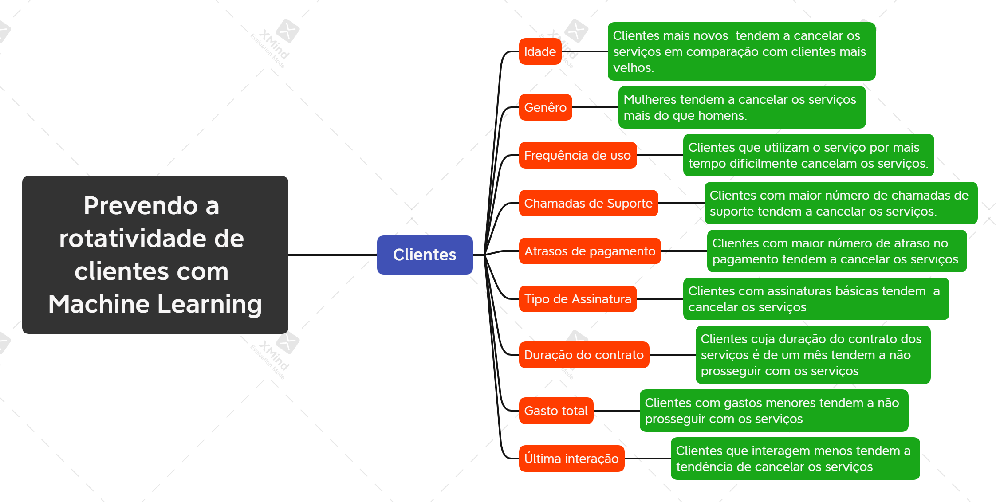

In [ ]:
Image( 'Mapa Mental de Hipóteses.png' )

### 9.1.2 Lista de Hipóteses

**1**. Clientes mais novos tendem a cancelar os serviços em comparação com os clientes mais velhos.

**2**. Mulheres tendem a cancelar os serviços mais do que os homens.

**3**. Clientes que utilizam os serviços por mais tempo dificilmente cancelam.

**4**. Clientes com maior número de chamadas de suporte tendem a cancelar os serviços.

**5**. Clientes com maior número de atraso no pagamento tendem a cancelar os serviços.

**6**. Clientes com assinaturas básicas tendem a cancelar os serviços.

**7**. Clientes cuja duração do contrato é de um mês tendem a não prosseguir com os serviços.

**8**. Clientes com gastoa menores tendem a não prosseguir com os serviços.

**9**. Clientes que interagem menos tem a tendência de cancelar os serviços.

## 9.2 Análise Univariada

### 9.2.1 Distribuição da variável resposta

C:\Users\HOME\AppData\Local\Temp\ipykernel_8164\2848238585.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(base_dados_clientes2['Churn']);


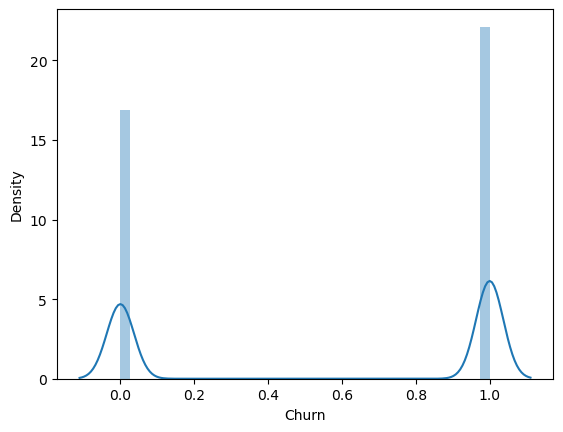

In [ ]:
# Plotando um gráfico de distribuição normal

sns.distplot(base_dados_clientes2['Churn']);

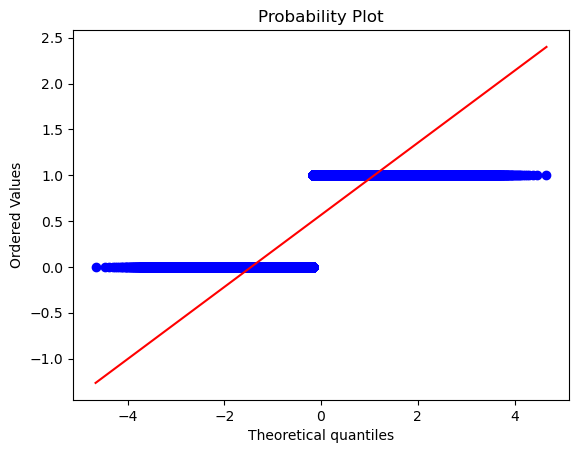

In [ ]:
# Executando o teste de Shapiro-Wilk para ver se a distribuição está normal

ss.probplot(base_dados_clientes2['Churn'], dist = 'norm', plot = pylab );

In [ ]:
# Executando teste de Shapiro

stat, p = ss.shapiro(base_dados_clientes2['Churn'] )
print('Teste de Shapiro-Wilk para normalidade: \n')
print( 'stat=%.3f, p=%.3f\n' % ( stat, p ) )
if p > 0.05:
    print( 'Provavelmente é Gaussiano' )
else:
    print( 'Provavelmente não é Gaussiano' )

Teste de Shapiro-Wilk para normalidade: 

stat=0.631, p=0.000

Provavelmente não é Gaussiano


C:\Users\HOME\anaconda3\lib\site-packages\scipy\stats\_morestats.py:1800: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


### 9.2.2 Separando as variáveis categóricas e númericas

In [ ]:
# Fazendo a divisão

atributos_numericos = base_dados_clientes2.select_dtypes( include = ['int32', 'int64', 'float64'] )
atributos_categoricos = base_dados_clientes2.select_dtypes( exclude = ['int32', 'int64', 'float64', 'datetime64[ns]'] )

In [ ]:
# Visualizando somente as variáveis númericas

variaveis_numericas = pd.DataFrame(base_dados_clientes2.select_dtypes(include='number').columns.to_list())
variaveis_numericas

,0
0,ID_cliente
1,Idade
2,Posse
3,Frequência_de_uso
4,Chamadas_de_suporte
5,Atraso_de_pagamento
6,Gasto_Total
7,Última_interação
8,Churn


In [ ]:
# Visualizando somente as variáveis categoricas

variaveis_categoricas = pd.DataFrame(base_dados_clientes2.select_dtypes(exclude='number').columns.to_list())
variaveis_categoricas

,0
0,Gênero
1,Tipo_de_assinatura
2,Duração_do_contrato


### 9.2.3 Analisando os atributos númericos

#### 9.2.3.1 Estatísticas Descritivas

In [ ]:
# Medidas de tendencia central (média e mediana)
ct1 = pd.DataFrame( atributos_numericos.apply( np.mean ) ).T
ct2 = pd.DataFrame( atributos_numericos.apply( np.median ) ).T


# Médidas de dispersão (desvio padrão, mínimo, máximo, faixa, assimetria, curtose
d1 = pd.DataFrame( atributos_numericos.apply( np.std ) ).T
d2 = pd.DataFrame( atributos_numericos.apply( min ) ).T
d3 = pd.DataFrame( atributos_numericos.apply( max ) ).T
d4 = pd.DataFrame(atributos_numericos.quantile( .25 )).T
d5 = pd.DataFrame(atributos_numericos.quantile( .75 )).T
d6 = pd.DataFrame( atributos_numericos.apply( lambda x: x.max() - x.min() ) ).T
d7 = pd.DataFrame( atributos_numericos.apply( lambda x: x.skew() ) ).T
d8 = pd.DataFrame( atributos_numericos.apply( lambda x: x.kurtosis() ) ).T


# Concatenando e imprimindo as medidas
m = pd.concat( [d2, d3, d6, d4,  ct2, d5, ct1, d1, d7, d8] ).T.reset_index()
m.columns = ['Atributos', 'mínimo', 'Máximo', 'Faixa', '25%','Mediana','75%', 'Média', 'Desvio Padrão', 'Assimétria', 'Curtose'] # Renomeando as colunas
m

,Atributos,mínimo,Máximo,Faixa,25%,Mediana,75%,Média,Desvio Padrão,Assimétria,Curtose
0,ID_cliente,2.0,449999.0,449997.0,113621.75,226125.5,337739.25,225398.667955,129531.771632,-0.018486,-1.200644
1,Idade,18.0,65.0,47.0,29.00,39.0,48.00,39.373153,12.442355,0.162016,-0.864853
2,Posse,1.0,60.0,59.0,16.00,32.0,46.00,31.256336,17.255708,-0.061402,-1.192523
3,Frequência_de_uso,1.0,30.0,29.0,9.00,16.0,23.00,15.807494,8.586232,-0.043473,-1.175815
4,Chamadas_de_suporte,0.0,10.0,10.0,1.00,3.0,6.00,3.604437,3.070214,0.666809,-0.745912
5,Atraso_de_pagamento,0.0,30.0,30.0,6.00,12.0,19.00,12.965722,8.258053,0.267407,-0.895678
6,Gasto_Total,100.0,1000.0,900.0,480.00,661.0,830.00,631.616223,240.802728,-0.457174,-0.751489
7,Última_interação,1.0,30.0,29.0,7.00,14.0,22.00,14.480868,8.596198,0.176774,-1.153760
8,Churn,0.0,1.0,1.0,0.00,1.0,1.00,0.567107,0.495476,-0.270881,-1.926632


#### 9.2.3.2 Distribuição das variáveis numéricas

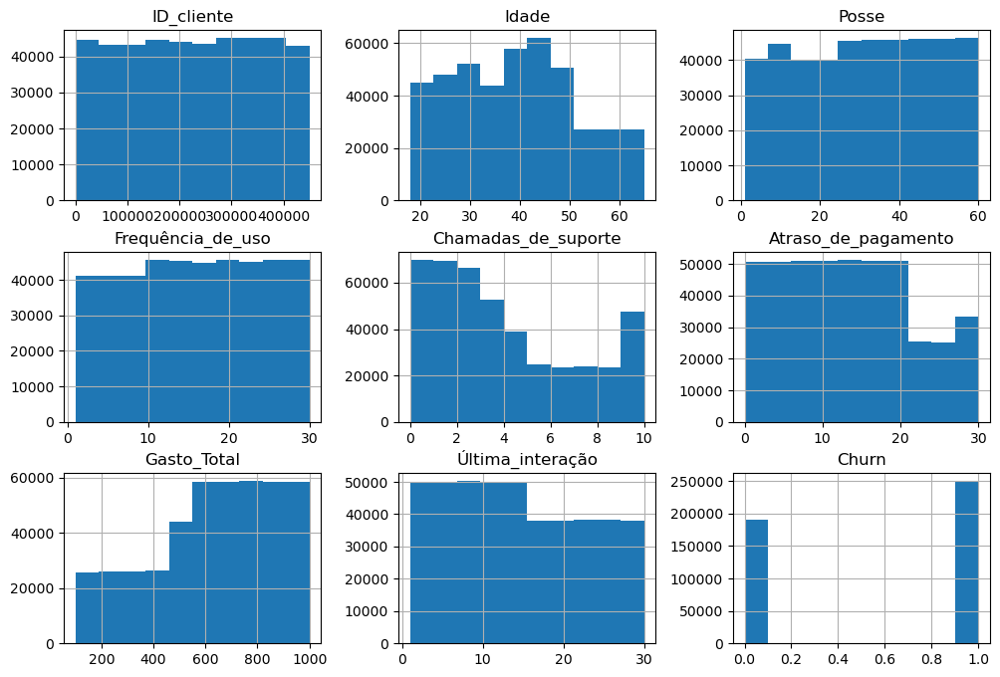

In [ ]:
# Distribuição dos valores numéricos

base_dados_clientes2.hist(figsize=(12,8));

## 9.3 Análise Bivariada - Validação de Hipóteses

### H1: Clientes mais novos tendem a cancelar os serviços em comparação com os clientes mais velhos.

Idade


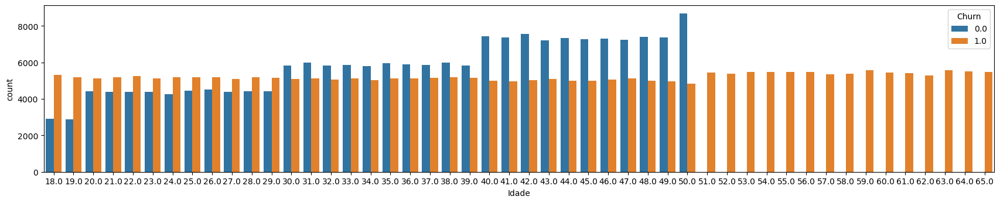

In [ ]:
# Idade x Churn
# Contagem de Churn por Idade

genero_churn = ['Idade'];

plot_num = 1
plt.figure(figsize=(50,10))
for i in genero_churn:
    print(i)
    ax = plt.subplot(3,3,plot_num)
    sns.countplot(x=base_dados_clientes2[i], hue=base_dados_clientes2['Churn'])
    plot_num +=1
plt.tight_layout()

**FALSO**: Assumindo 0.0 (cancelou) 1.0 (não cancelou), os clientes mais velhos, a partir de 51 anos, cancelaram os serviços. Já clientes entre 30 e 50 anos não cancelaram. A maioria dos clientes entre 18 e 29 anos cancelaram os serviços.

### H2:  Mulheres tendem a cancelar os serviços mais do que os homens.

Gênero


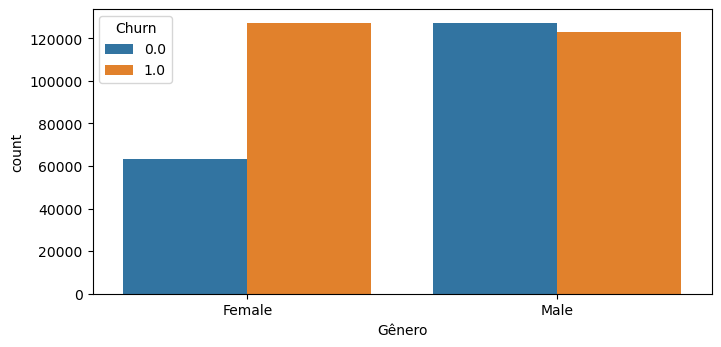

In [ ]:
 # Plotando um gráfico relacionando Gênero x Churn

genero_churn = ['Gênero'];

plot_num = 1
plt.figure(figsize=(20,10))
for i in genero_churn:
    print(i)
    ax = plt.subplot(3,3,plot_num)
    sns.countplot(x=base_dados_clientes2[i], hue=base_dados_clientes2['Churn'])
    plot_num +=1
plt.tight_layout()

**FALSO**: Assumindo 0.0 (cancelou) 1.0 (não cancelou), existem mais homens do que mulheres que cancelaram o serviço. Em contrapartida, existe mais mulheres do que homens que não cancelaram os serviços, embora com uma distância pequena. Com base nisso, é necessário entender os motivos que levaram mais pessoas do sexo masculino a cancelar os serviços e tomar medidas como forma de reter essas pessoas do sexo masculino.

### H3: Clientes que utilizam os serviços por mais tempo dificilmente cancelam.

Frequência_de_uso


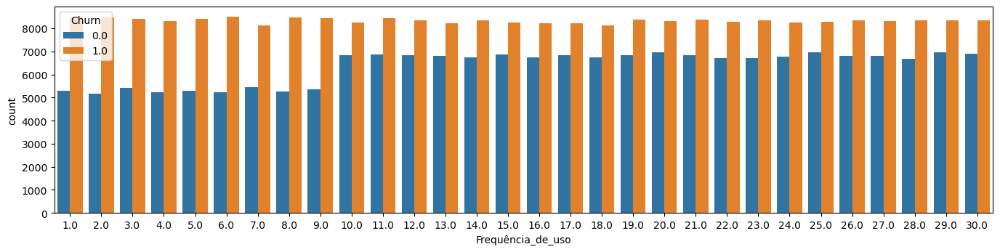

In [ ]:
# Frequência de uso x Churn
# Contagem de Churn por Frequência de uso

genero_churn = ['Frequência_de_uso'];

plot_num = 1
plt.figure(figsize=(40,10))
for i in genero_churn:
    print(i)
    ax = plt.subplot(3,3,plot_num)
    sns.countplot(x=base_dados_clientes2[i], hue=base_dados_clientes2['Churn'])
    plot_num +=1
plt.tight_layout()

**FALSO**: Assumindo 0.0 (cancelou) 1.0 (não cancelou), dentre os clientes que possui maior frequência, a maioria cancelaram. Inclusive, em todas as frequência de uso que aparecem no gráfico, o número de clientes que cancelaram o serviço é maior do que o número de clientes que não cancelaram. Sendo assim, é necessário entender porque o número de cancelamentos é maior em todas as frequências de uso e tomar as medidas necessárias para contornar tal situação.

### H4: Clientes com maior número de chamadas de suporte tendem a cancelar os serviços.

Chamadas_de_suporte


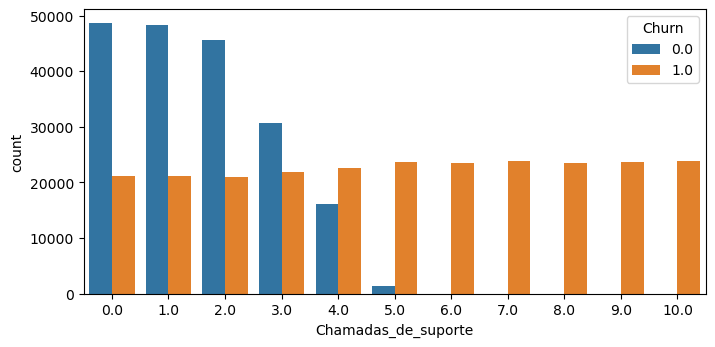

In [ ]:
# Chamadas_de_suporte x Churn
# Contagem de Churn por Chamadas_de_suporte

genero_churn = ['Chamadas_de_suporte'];

plot_num = 1
plt.figure(figsize=(20,10))
for i in genero_churn:
    print(i)
    ax = plt.subplot(3,3,plot_num)
    sns.countplot(x=base_dados_clientes2[i], hue=base_dados_clientes2['Churn'])
    plot_num +=1
plt.tight_layout()


**FALSO**: Assumindo 0.0 (cancelou) 1.0 (não cancelou), conforme o gráfico, dentre os clientes que possui maior n´´umero de suporte, isto é, número de chamada de suporte a partir de 6.0, não houve cancelamento.

### H5: Clientes com maior número de atraso no pagamento tendem a cancelar os serviços.

Atraso_de_pagamento


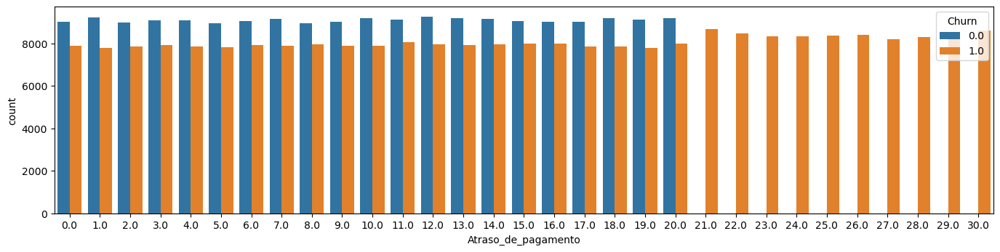

In [ ]:
# Atraso_de_pagamento x Churn
# Contagem de Churn por Atraso_de_pagamento

genero_churn = ['Atraso_de_pagamento'];

plot_num = 1
plt.figure(figsize=(40,10))
for i in genero_churn:
    print(i)
    ax = plt.subplot(3,3,plot_num)
    sns.countplot(x=base_dados_clientes2[i], hue=base_dados_clientes2['Churn'])
    plot_num +=1
plt.tight_layout()

**FALSO**: Assumindo 0.0 (cancelou) 1.0 (não cancelou), não necessariamente, pois perceba pelo gráfico que os clientes com 21 atrasos em diante não cancelaram o serviço.

### H6: Clientes com assinaturas básicas tendem a cancelar os serviços.

Tipo_de_assinatura


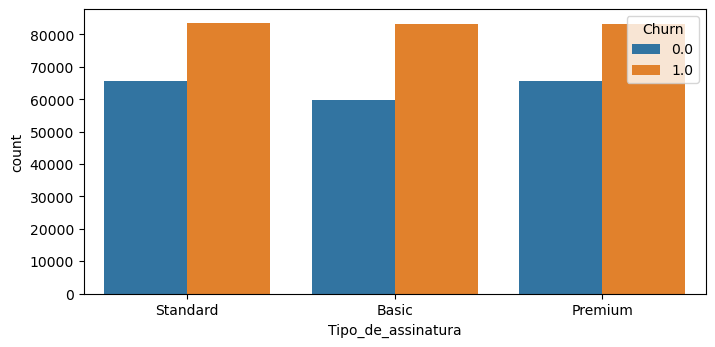

In [ ]:
# Plotando um gráfico relacionando Tipo de assinatura x Churn
# Contagem de Churn por Tipo de assinatura

genero_churn = ['Tipo_de_assinatura'];

plot_num = 1
plt.figure(figsize=(20,10))
for i in genero_churn:
    print(i)
    ax = plt.subplot(3,3,plot_num)
    sns.countplot(x=base_dados_clientes2[i], hue=base_dados_clientes2['Churn'])
    plot_num +=1
plt.tight_layout()

**FALSO**: Assumindo 0.0 (cancelou) 1.0 (não cancelou), dentre os clientes que possuem assinaturas básicas, a maioria não cancelaram o serviço. O mesmo ocorre com clientes que possuem assinatura padrão e assinatura primium.

### H7: Clientes cuja duração do contrato é de um mês tendem a não prosseguir com os serviços.

Duração_do_contrato


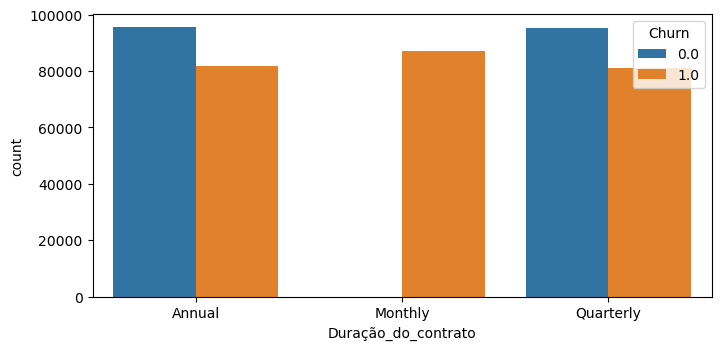

In [ ]:
# Plotando um gráfico relacionando Duração_do_contrato x Churn

genero_churn = ['Duração_do_contrato'];

plot_num = 1
plt.figure(figsize=(20,10))
for i in genero_churn:
    print(i)
    ax = plt.subplot(3,3,plot_num)
    sns.countplot(x=base_dados_clientes2[i], hue=base_dados_clientes2['Churn'])
    plot_num +=1
plt.tight_layout()

**FALSO**: Assumindo 0.0 (cancelou) 1.0 (não cancelou), dentre os clientes existentes na base de dados, todos que possuem contrato de um mês não cancelaram o serviço.

### H8: Clientes com gastos menores tendem a não prosseguir com os serviços.

In [ ]:
# Gasto_Total x Churn
# Contagem de Churn por Gasto_Total

genero_churn = ['Gasto_Total'];

plot_num = 1
plt.figure(figsize=(40,10))
for i in genero_churn:
    print(i)
    ax = plt.subplot(3,3,plot_num)
    sns.countplot(x=base_dados_clientes2[i], hue=base_dados_clientes2['Churn'])
    plot_num +=1
plt.tight_layout()

Gasto_Total


**FALSO**: Assumindo 0.0 (cancelou) 1.0 (não cancelou),

### H9: Clientes que interagem menos tem a tendência de cancelar os serviços.

In [ ]:
# Última_interação x Churn
# Contagem de Churn por Última_interação

genero_churn = ['Última_interação'];

plot_num = 1
plt.figure(figsize=(40,10))
for i in genero_churn:
    print(i)
    ax = plt.subplot(3,3,plot_num)
    sns.countplot(x=base_dados_clientes2[i], hue=base_dados_clientes2['Churn'])
    plot_num +=1
plt.tight_layout()

**FALSO**: Assumindo 0.0 (cancelou) 1.0 (não cancelou),

## 9.4 Análise Multivariada

### 9.4.1 Atributos numéricos

In [ ]:
# Visualizando somente as variáveis númericas

variaveis_numericas = pd.DataFrame(base_dados_clientes2.select_dtypes(include='number').columns.to_list())
variaveis_numericas

,0
0,ID_cliente
1,Idade
2,Posse
3,Frequência_de_uso
4,Chamadas_de_suporte
5,Atraso_de_pagamento
6,Gasto_Total
7,Última_interação
8,Churn


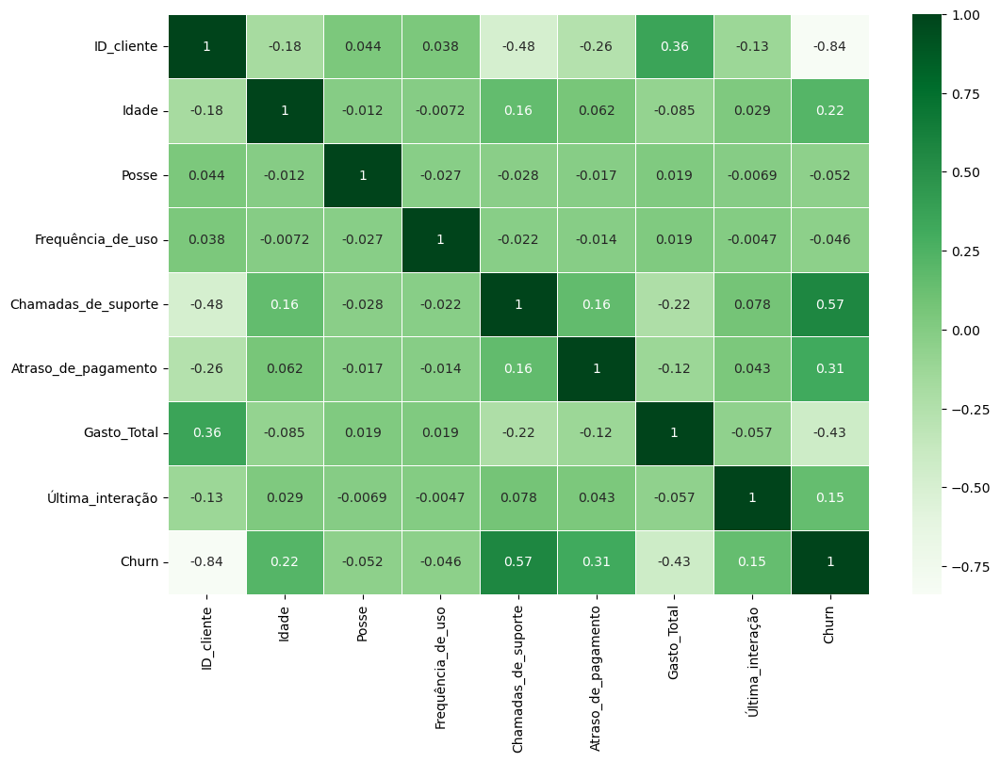

In [ ]:
# Verificando a correlação entre as variáveis númericas

fig, ax = plt.subplots(figsize=(12,8))

_ = sns.heatmap(atributos_numericos.corr(), cmap = 'Greens', linewidth = 0.5, annot = True)

### 9.4.2 Atributos categóricos

In [ ]:
# Visualizando as variáveis categoricas

variaveis_categoricas = pd.DataFrame(base_dados_clientes2.select_dtypes(exclude='number').columns.to_list())
variaveis_categoricas

,0
0,Gênero
1,Tipo_de_assinatura
2,Duração_do_contrato


In [ ]:
# Função para executar um coeficiente de correlação com variáveis categóricas

def cramer_v( x, y ):
    cm = pd.crosstab( x, y ).to_numpy()
    n = cm.sum()
    r, k = cm.shape

    chi2 = ss.chi2_contingency( cm )[0]
    chi2corr = max( 0, chi2 - (k-1)*(r-1)/(n-1) )

    #Corrigindo o viés V de Cramer
    kcorr = k - (k-1)**2/(n-1)
    rcorr = r - (r-1)**2/(n-1)

    return np.sqrt( (chi2corr/n) / ( min( kcorr-1, rcorr-1 ) ) )

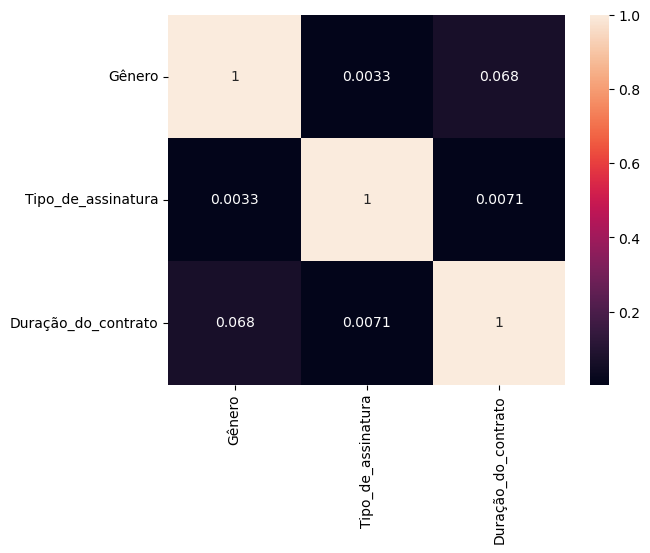

In [ ]:
# Obtendo apenas dados categóricos
a = base_dados_clientes2.select_dtypes( include='object' )

# Calculando cramer V
a1 = cramer_v( a['Gênero'], a['Gênero'] )
a2 = cramer_v( a['Gênero'], a['Tipo_de_assinatura'] )
a3 = cramer_v( a['Gênero'], a['Duração_do_contrato'] )


a4 = cramer_v( a['Tipo_de_assinatura'], a['Gênero'] )
a5 = cramer_v( a['Tipo_de_assinatura'], a['Tipo_de_assinatura'] )
a6 = cramer_v( a['Tipo_de_assinatura'], a['Duração_do_contrato'] )

a7 = cramer_v( a['Duração_do_contrato'], a['Gênero'] )
a8 = cramer_v( a['Duração_do_contrato'], a['Tipo_de_assinatura'] )
a9 = cramer_v( a['Duração_do_contrato'], a['Duração_do_contrato'] )


# Conjunto de dados final
d = pd.DataFrame( {'Gênero': [a1, a2, a3],
                'Tipo_de_assinatura': [a4,a5,a6],
                'Duração_do_contrato': [a7,a8, a9],})

d = d.set_index( d.columns )

sns.heatmap( d, annot=True );

# 10. ETAPA V: Aplicando os algoritmos de Agrupamento

**Algoritmos utilizados**

**1**. K-means

**2**. Agrupamento hierárquico

**3**. DBSCAN

* Agrupar gastos por idade, gastos por gênero, gastos por tipo de assinatura, gastos por duração do contrato

## 10.1 K-means

### 10.1.1 Agrupando Gasto Total por Idade

In [11]:
# Passando (Idade e Gasto_Total) para o formato numpy array

X_clientes = base_dados_clientes2.iloc[:, [1, 9]].values
X_clientes

array([[ 30.  , 932.  ],
       [ 65.  , 557.  ],
       [ 55.  , 185.  ],
       ...,
       [ 26.  , 977.31],
       [ 28.  , 602.55],
       [ 31.  , 567.77]])

In [12]:
# Escalonando as duas variáveis para que os dados fiquem na mesma escala

scaler_clientes = StandardScaler()
X_clientes = scaler_clientes.fit_transform(X_clientes)
X_clientes

array([[-0.7533263 ,  1.2474268 ],
       [ 2.05964592, -0.30986452],
       [ 1.25593957, -1.85469752],
       ...,
       [-1.07480884,  1.43558912],
       [-0.91406757, -0.12070554],
       [-0.67295566, -0.26513912]])

In [ ]:
# Aplicando a técnica do WCSS para definirmos o número de clusters

wcss = []
for i in range(1, 11):
  #print(i)
  kmeans_clientes = KMeans(n_clusters=i, random_state=0)
  kmeans_clientes.fit(X_clientes)
  wcss.append(kmeans_clientes.inertia_)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

In [ ]:
wcss

[881663.9999999962,
 560156.5147794873,
 363198.07333977555,
 257132.50820102473,
 209076.0254966282,
 172397.81010739447,
 141440.76691446663,
 124647.46735824164,
 110208.61674744531,
 98909.22513390263]

* Como nessa base de dados não temos ideia de quantos clusters vamos gerar, aplicamos a técnica do WCSS.


* Vamos fazer o teste com até 10 clusters.

In [ ]:
# Visualizando clusters graficamente

grafico = px.line(x = range(1,11), y = wcss)
grafico.show()

In [ ]:
# Criando e treinando o algoritmo

kmeans_clientes = KMeans(n_clusters=4, random_state=0)
rotulos = kmeans_clientes.fit_predict(X_clientes)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



In [ ]:
# Gerando o gráfico

grafico = px.scatter(x = X_clientes[:,0], y = X_clientes[:,1], color=rotulos)
grafico.show()

* Agora podemos fazer a análise dos grupos. No eixo x temos a idade (quanto mais para a direita maior a idade) e no eixo y temos o gasto total (quanto mais na parte superior/cima do gráfico maior é o gasto total do cliente).


* Por exemplo, esse grupo azul que é o grupo 0 são as pessoas mais jovens e que os gastos são menores.

* O grupo amarelo são pessoas mais velhas com gastos menores.

* O grupo roxo são pessoas jovens e com gastos maiores.

* O grupo laranja são pessoas mais velhas com gastos maiores.

* Para essas pessoas que tem gastos menores, é interessante buscar compreender melhor seu perfil de compra e direcionar as vendas para elas de acordo com esse perfil, assim pode ser que elas compram mais e seu gasto aumente.

 ##### >>> Lista de Clientes Ordenadas por Grupos









In [ ]:
# Lista de Clientes ordenadas pelos grupos do agrupamento

lista_clientes = np.column_stack((base_dados_clientes2, rotulos))
lista_clientes = pd.DataFrame(lista_clientes[lista_clientes[:,12].argsort()])
lista_original = ['0', '1','2','3','4', '5', '6', '7', '8', '9', '10','11','12']
lista_renomeada = ["ID_cliente", "Idade", "Gênero", "Posse", "Frequência_de_uso", "Chamadas_de_suporte", "Atraso_de_pagamento", "Tipo_de_assinatura", "Duração_do_contrato", "Gasto_Total","Última_interação","Churn","Grupos"]
lista_clientes.columns = lista_renomeada
lista_clientes

,ID_cliente,Idade,Gênero,Posse,Frequência_de_uso,Chamadas_de_suporte,Atraso_de_pagamento,Tipo_de_assinatura,Duração_do_contrato,Gasto_Total,Última_interação,Churn,Grupos
0,449999.0,31.0,Male,48.0,20.0,1.0,14.0,Premium,Quarterly,567.77,21.0,0.0,0
1,116879.0,28.0,Male,42.0,22.0,9.0,19.0,Premium,Quarterly,295.0,1.0,1.0,0
2,116878.0,23.0,Male,56.0,24.0,9.0,8.0,Premium,Annual,232.0,12.0,1.0,0
3,297276.0,39.0,Male,43.0,15.0,3.0,9.0,Premium,Annual,525.38,5.0,0.0,0
4,116873.0,39.0,Male,11.0,20.0,0.0,13.0,Standard,Monthly,238.0,29.0,1.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
440827,301253.0,50.0,Female,45.0,21.0,3.0,19.0,Basic,Annual,500.01,2.0,0.0,3
440828,113715.0,42.0,Female,9.0,18.0,10.0,30.0,Premium,Annual,187.0,11.0,1.0,3
440829,113717.0,55.0,Male,48.0,8.0,7.0,8.0,Standard,Annual,151.0,21.0,1.0,3
440830,113678.0,55.0,Female,56.0,20.0,8.0,29.0,Premium,Monthly,233.0,22.0,1.0,3


### 10.1.2 Agrupamento com mais atributos

* Utilizando a mesma base anterior, porém anteriormente utilizamos somente os idade e o gasto total. Porém, quanndo trabalhamos com essa área de agrupamento em aplicações comerciais é bem comum utilizar o agrupamento com todos os atributos disponíveis na base de dados ou com os atributos que são de interesse da empresa.

In [ ]:
# Visualizando as colunas da base de dados

base_dados_clientes2.columns

Index(['ID_cliente', 'Idade', 'Gênero', 'Posse', 'Frequência_de_uso',
       'Chamadas_de_suporte', 'Atraso_de_pagamento', 'Tipo_de_assinatura',
       'Duração_do_contrato', 'Gasto_Total', 'Última_interação', 'Churn'],
      dtype='object')

In [ ]:
base_dados_clientes2.head()

,ID_cliente,Idade,Gênero,Posse,Frequência_de_uso,Chamadas_de_suporte,Atraso_de_pagamento,Tipo_de_assinatura,Duração_do_contrato,Gasto_Total,Última_interação,Churn
0,2.0,30.0,Female,39.0,14.0,5.0,18.0,Standard,Annual,932.0,17.0,1.0
1,3.0,65.0,Female,49.0,1.0,10.0,8.0,Basic,Monthly,557.0,6.0,1.0
2,4.0,55.0,Female,14.0,4.0,6.0,18.0,Basic,Quarterly,185.0,3.0,1.0
3,5.0,58.0,Male,38.0,21.0,7.0,7.0,Standard,Monthly,396.0,29.0,1.0
4,6.0,23.0,Male,32.0,20.0,5.0,8.0,Basic,Monthly,617.0,20.0,1.0


In [ ]:
# Passandos as colunas para o formato numpy array

X_clientes_mais_atributos = base_dados_clientes2.iloc[:,[1,3,4,5,6,9,10,11]].values
X_clientes_mais_atributos

array([[ 30.  ,  39.  ,  14.  , ..., 932.  ,  17.  ,   1.  ],
       [ 65.  ,  49.  ,   1.  , ..., 557.  ,   6.  ,   1.  ],
       [ 55.  ,  14.  ,   4.  , ..., 185.  ,   3.  ,   1.  ],
       ...,
       [ 26.  ,  35.  ,  27.  , ..., 977.31,   9.  ,   0.  ],
       [ 28.  ,  55.  ,  14.  , ..., 602.55,   2.  ,   0.  ],
       [ 31.  ,  48.  ,  20.  , ..., 567.77,  21.  ,   0.  ]])

In [ ]:
# Escalonando das variáveis para que os dados fiquem na mesma escala

scaler_clientes_mais = StandardScaler()
X_clientes_mais_atributos = scaler_clientes.fit_transform(X_clientes_mais_atributos)
X_clientes_mais_atributos

array([[-0.7533263 ,  0.44875958, -0.21051068, ...,  1.2474268 ,
         0.29305188,  0.87369048],
       [ 2.05964592,  1.02827797, -1.7245625 , ..., -0.30986452,
        -0.98658361,  0.87369048],
       [ 1.25593957, -1.00003639, -1.37516593, ..., -1.85469752,
        -1.33557511,  0.87369048],
       ...,
       [-1.07480884,  0.21695223,  1.30354113, ...,  1.43558912,
        -0.63759211, -1.1445701 ],
       [-0.91406757,  1.37598901, -0.21051068, ..., -0.12070554,
        -1.45190561, -1.1445701 ],
       [-0.67295566,  0.97032613,  0.48828246, ..., -0.26513912,
         0.75837388, -1.1445701 ]])

In [ ]:
# Aplicando a técnica do WCSS para descobrirmos o número ideial de clusters

wcss = []
for i in range(1, 11):
  kmeans_clientes_mais_atributos = KMeans(n_clusters = i, random_state = 0);
  kmeans_clientes_mais_atributos.fit(X_clientes_mais_atributos);
  wcss.append(kmeans_clientes_mais_atributos.inertia_);


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will chang

In [ ]:
wcss

[3526656.000000013,
 2777927.138233741,
 2542472.787209887,
 2391925.34355202,
 2262855.6841390785,
 2156520.4439310376,
 2062516.3151697011,
 1990893.0841803835,
 1923970.7446702262,
 1863826.5938001066]

In [ ]:
# Visualizando clusters graficamente

grafico = px.line(x = range(1,11), y = wcss)
grafico.show()

* Podemos observar que com somente um clusters temos o valor de 3.5, 2 clusters 2.7 e, assim, por diante.

In [ ]:
# Criando e treinando o algoritmo

kmeans_clientes_mais_atributos = KMeans(n_clusters=2, random_state=0) # n_clusters=2
rotulos = kmeans_clientes_mais_atributos.fit_predict(X_clientes_mais_atributos)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



In [ ]:
# Visualizando através da variável rotulos a qual clusters cada registro pertence

rotulos

array([1, 1, 1, ..., 0, 0, 0], dtype=int32)

In [ ]:
# Aplicando o PCA

pca = PCA(n_components=2) # n_components=2 é quantos atributos. Enviamos a base completa e obtemos retorno somente com dois atributos.
X_clientes_mais_atributos_pca = pca.fit_transform(X_clientes_mais_atributos)  # Enviamos a variável com 6 atributos

In [ ]:
# Visualizando tamanho

X_clientes_mais_atributos_pca.shape

(440832, 2)

* Temos os 440832 registros e somente 2 atributos.

* Os 2 atributos foram gerados por meio da combinação dos 6 atributos já existentes.

In [ ]:
# Visualizando os valores

X_clientes_mais_atributos_pca

array([[ 0.284079  ,  0.46525059],
       [ 1.91420331,  1.9182296 ],
       [ 2.11698152,  0.30672045],
       ...,
       [-2.48472253, -0.78761526],
       [-1.95475376,  1.12775786],
       [-1.10444895,  0.3390196 ]])

In [ ]:
# Fazendo a geração do gráfico por meio da variável X_cartao_mais_pca

grafico = px.scatter(x= X_clientes_mais_atributos_pca[:,0], y = X_clientes_mais_atributos_pca[:,1], color=rotulos)
grafico.show()

* Neste caso não podemos fazer a mesma análise que anterior, isto é, de falar que no eixo x temos a idade e no eixo y o gasto total, pois neste caso temos 2 novos atributos que foram gerados por meio dos atributos já existentes. Então a análise acaba ficando mais complexa e é interessante mais pela visualização de resultados.

##### >>> Lista de Clientes Ordenadas por Grupos

In [ ]:
# Lista de clientes - Combinando os resultados para a empresa analisar qual cliente pertence a cada um dos grupos

lista_clientes = np.column_stack((base_dados_clientes2, rotulos))
lista_clientes = pd.DataFrame(lista_clientes[lista_clientes[:,12].argsort()])
lista_original = ['0', '1','2','3','4', '5', '6', '7', '8', '9', '10','11','12']
lista_renomeada = ["ID_cliente", "Idade", "Gênero", "Posse", "Frequência_de_uso", "Chamadas_de_suporte", "Atraso_de_pagamento", "Tipo_de_assinatura", "Duração_do_contrato", "Gasto_Total","Última_interação","Churn","Grupos"]
lista_clientes.columns = lista_renomeada
lista_clientes

,ID_cliente,Idade,Gênero,Posse,Frequência_de_uso,Chamadas_de_suporte,Atraso_de_pagamento,Tipo_de_assinatura,Duração_do_contrato,Gasto_Total,Última_interação,Churn,Grupos
0,449999.0,31.0,Male,48.0,20.0,1.0,14.0,Premium,Quarterly,567.77,21.0,0.0,0
1,321136.0,39.0,Male,8.0,7.0,0.0,6.0,Standard,Annual,683.37,29.0,0.0,0
2,321135.0,32.0,Female,10.0,22.0,2.0,2.0,Standard,Annual,777.11,10.0,0.0,0
3,321134.0,21.0,Male,1.0,27.0,0.0,18.0,Standard,Quarterly,757.7,25.0,0.0,0
4,321133.0,50.0,Female,59.0,25.0,4.0,8.0,Standard,Quarterly,674.07,6.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
440827,154131.0,41.0,Female,44.0,29.0,5.0,10.0,Standard,Monthly,836.0,23.0,1.0,1
440828,154130.0,47.0,Female,22.0,30.0,9.0,12.0,Premium,Quarterly,796.0,26.0,1.0,1
440829,154129.0,39.0,Male,59.0,15.0,6.0,21.0,Basic,Monthly,456.0,3.0,1.0,1
440830,154156.0,53.0,Female,38.0,13.0,8.0,28.0,Standard,Monthly,348.0,17.0,1.0,1


## 10.2 Agrupamento hierárquico

* Não conseguir fazer a aplicação do agrupamento hieráquico nem pelo jupyter notebook na minha máquina nem no google colab devido a insuficiência de memória necessária a aplicação desse algoritmo. De qualquer forma, abaixo tem listado como seria o passo a passo dos códigos para aplicação desse algoritmo.

In [8]:
# Visualizando os dados já padronizados
X_clientes
# Importando a biblioteca para o agrupamento hierárquico
from sklearn.cluster import AgglomerativeClustering
# Gerando o dendograma para obtermos qual é o número ideal de clusters
dendrograma = dendrogram(linkage(X_clientes, method = 'ward'))
# Aplicando o agrupamento
hc_clientes = AgglomerativeClustering(n_clusters=3, affinity='euclidean', linkage = 'ward')
rotulos = hc_clientes.fit_predict(X_clientes)
rotulos
# Gerando o gráfico para visualizarmos cada um dos clusters
grafico = px.scatter(x = X_clientes[:,0], y = X_clientes[:,1], color = rotulos)
grafico.show()

## 10.3 DBSCAN

In [9]:
# Visualizando valores escalonados
X_clientes
# Criando o algoritmo e passando os dados
dbscan_clientes = DBSCAN(eps=0.37, min_samples=5)
rotulos = dbscan_clientes.fit_predict(X_clientes)
# Visualizando os rótulos
rotulos
# Contagem de elementos
np.unique(rotulos, return_counts=True)
# Gerando o gráfico para visualizar o agrupamento
grafico = px.scatter(x = X_clientes[:,0], y = X_clientes[:,1], color = rotulos)
grafico.show()

## 10.4 K-means x Hierárquico x DBSCAN

In [10]:
# Importanto as bases de dados pré definidas no sklearn

from sklearn import datasets

In [11]:
# Gerando 1500 registros aleatórios

X_random, y_random = datasets.make_moons(n_samples=1500, noise = 0.09) # Para os dados ficarem mais dispersos

In [12]:
X_random

array([[-0.64802751,  0.67655126],
       [ 0.17734393,  0.21499483],
       [ 0.91760119,  0.1765024 ],
       ...,
       [ 0.7962845 , -0.34216432],
       [ 2.00410087, -0.03282251],
       [ 0.86787677, -0.5193451 ]])

In [13]:
# Visualizando o número de grupos

y_random

array([0, 1, 0, ..., 1, 1, 1])

In [14]:
# Conferindo número de grupos

np.unique(y_random)

array([0, 1])

In [15]:
# Visualizando distribuição dos grupos graficamente

grafico = px.scatter(x = X_random[:,0], y = X_random[:,1])
grafico.show()

* Temos dois grupos.

* O que vamos fazer agora é aplicar os três algoritmos (k-means, agrupamento hierárquico e DSCAN) e verificar qual deles vai consegir fazer a divisão correta dos grupos

In [16]:
# Gerando o Kmeans, obtendo os rótulos e gerando o gráfico

kmeans = KMeans(n_clusters=2)
rotulos = kmeans.fit_predict(X_random)
grafico = px.scatter(x = X_random[:,0], y = X_random[:, 1], color = rotulos)
grafico.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



* Note que não é possível utlizar o algoritmo k-means para agrupar esse tipo de superficie, pois como são feitos cálculos de distância, os registros acabam ficando perto um dos outros registros, o que acaba não ficando totalmente correto. O algoritmo não vai conseguir identificar ou separar essa superficie e como não é possível passar parâmetros para o algoritmo k-means nós não vamos conseguir fazer um agrupamento interessante considerando esses dados.

In [20]:
# Importando a biblioteca para o agrupamento hierárquico

from sklearn.cluster import AgglomerativeClustering # Temos essa classe AgglomerativeClustering que é considerado o agrupamento hierárquico.

In [21]:
# Gerando o Agrupamento Hierárquico, obtendo os rótulos e gerando o gráfico

hc = AgglomerativeClustering(n_clusters=2, affinity='euclidean', linkage='ward')
rotulos = hc.fit_predict(X_random)
grafico = px.scatter(x = X_random[:,0], y = X_random[:, 1], color = rotulos)
grafico.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_agglomerative.py:983: FutureWarning:

Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead



* Temos um resultado um pouquinho melhor, pois com o algoritmo k-means ele misturou as duas classes, isto é, o amarelo ficou azul e o azul ficou amarelo. O agrupamento hierárquico acabou mistuando elementos somente da classe azul, pois eles estão mais próximos, mas o algoritmo conseguiu agrupar corretamente todos esses registros.

In [22]:
# Gerando o DBSCAN obtendo os rótulos e gerando o gráfico

dbscan = DBSCAN(eps=0.1)
rotulos = dbscan.fit_predict(X_random)
grafico = px.scatter(x = X_random[:,0], y = X_random[:, 1], color = rotulos)
grafico.show()

* Note que ele não conseguiu fazer a divisão dos grupos com parâmetro eps=0.5), porém é importante que você faça alguns testes com os parâmetros. Sendo assim, colocando o parâmetro (eps=0.1), temos uma divisão dos grupos praticamente perfeita. O grupo amarelo, o grupo vermelho e o o grupo azul que tem registros negativos que ele não conseguiu associar a nenhum dos grupos. Essa divisão de grupos correta faz sentido pelo fato de que estamos definindo um raio pequeno, fazendo com que por exemplo, registros do grupo vermelho não pegue registros do grupo amarelo e vice-versa.


* Esse experimento é interessante para você saber quando aplicar cada um dos algoritmos. Para aplicações mais tradicionais com dados conforme vimos anteriormente do cartão de crédito e do salário, os dois primeiros algoritmos são mais adequados e para problemas mais complextos, superficies que não são tão fáceis assim para você agrupar você pode utilizar o algoritmo DBSCAN.

## 10.5 Testando agrupamento com algumas colunas entre si

### 10.5.1 Gasto Total por Idade de acordo com o Gênero

C:\Users\HOME\anaconda3\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.



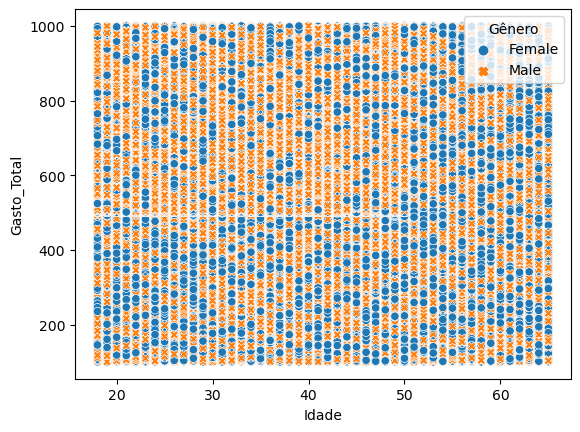

In [ ]:
# Gasto Total por Idade de acordo com o Gênero

sns.scatterplot(data=base_dados_clientes2, x="Idade", y="Gasto_Total", hue="Gênero", style="Gênero")
plt.show()

### 10.5.2 Gasto Total por Idade de acordo com o Tipo_de_assinatura

C:\Users\HOME\anaconda3\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.



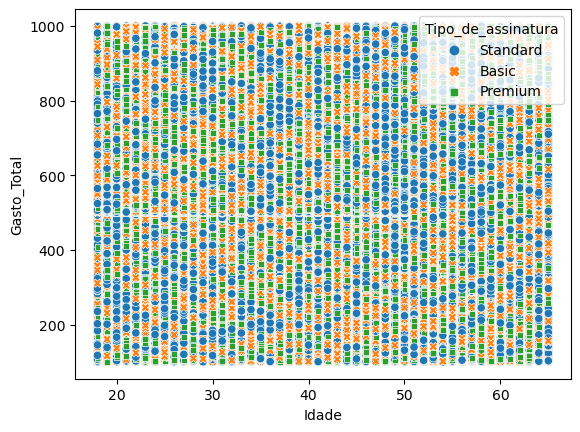

In [ ]:
# Gasto Total por Idade de acordo com o Tipo_de_assinatura

sns.scatterplot(data=base_dados_clientes2, x="Idade", y="Gasto_Total", hue="Tipo_de_assinatura", style="Tipo_de_assinatura")
plt.show()

### 10.5.3 Gasto Total por Idade de acordo com a Duração_do-contrato

C:\Users\HOME\anaconda3\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.



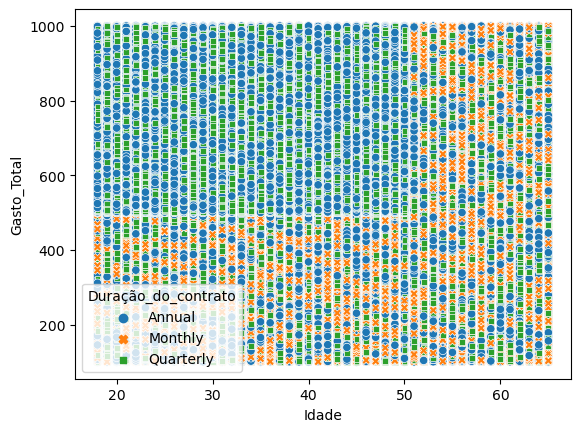

In [ ]:
# Gasto Total por Idade de acordo com o Tipo_de_assinatura

sns.scatterplot(data=base_dados_clientes2, x="Idade", y="Gasto_Total", hue="Duração_do_contrato", style="Duração_do_contrato")
plt.show()

### 10.5.4 Gasto total e Última interação por idade

C:\Users\HOME\anaconda3\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.



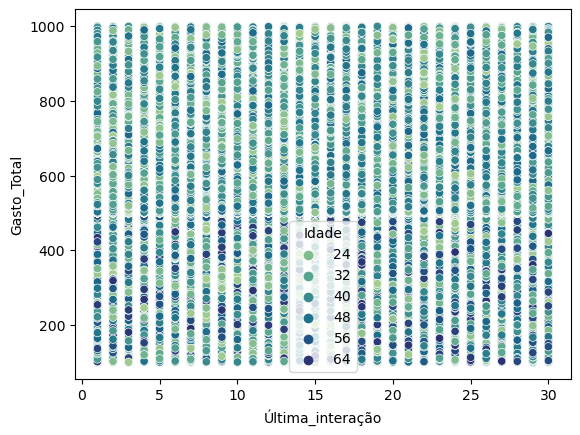

In [ ]:
# Gasto total e Última interação por idade

sns.scatterplot(data=base_dados_clientes2, x="Última_interação", y="Gasto_Total", hue="Idade", palette='crest')
plt.show()

### 10.5.5 Agrupando Gasto Total e Idade em cinco Grupos

C:\Users\HOME\anaconda3\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.



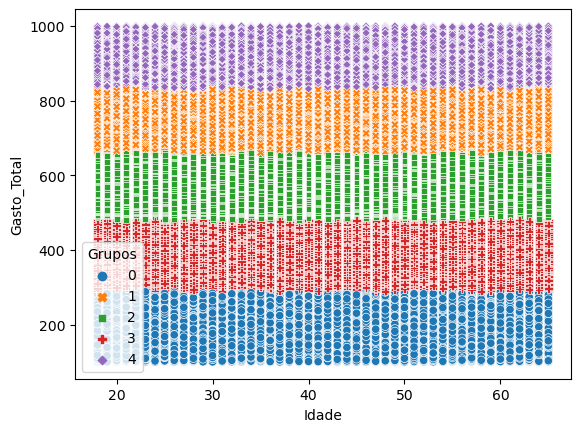

In [ ]:
# Gasto Total e Idade em cinco grupos

sns.scatterplot(data=base_dados_clientes2, x="Idade", y="Gasto_Total", hue='Grupos', style='Grupos', palette='tab10')
plt.show()

# 11. ETAPA VI: Tradução dos resultados para métricas de negócios

* O objetivo do agrupamento neste projeto foi agrupar os clientes com base nos atributos/características fornecidas pela base de dados.


* Com isso, é possível entender o perfil de cada um dos clientes e, assim, direcionar melhor as vendas, constribuido para o aumento de receitas.


* Nesse sentido, uma vez feita o agrupamento dos clientes acima de acordo com algumas características é possível entender melhor o perfil dos clientes, e com a lista desses clientes traçar algumas medidas, seja de fidelização ou de atração o que pode trazer ganhos de receitas, aumentando assim o lucro.